# Mount Google Drive (only works on Colab)
We used Google Colab to collaborate on the notebook. Because of the way Colab works, we have to save the dataset to our Google Drive and mount it to the environment every time. To run this notebook locally, you need to:

1. Comment out the `drive.mount` cell below.
2. Have the dataset on the same folder.
3. Change the value of `csvFile` variable.

Dependencies for the notebooks include:
```
pandas
matplotlib
scikit-learn
seaborn
```

In [1]:
# COMMENT OUT THIS CELL IF RUNNING LOCALLY
# from google.colab import drive
# drive.mount('/content/gdrive/', force_remount=True)

# Applications of data science and machine learning with Python for the progression of COVID

Dataset used taken from: [https://ourworldindata.org/coronavirus](https://ourworldindata.org/coronavirus)

Due to the vastness of the dataset, we decide to limit the scope to just ASEAN countries. The project can be divided into 2 parts:

1. Exploring the relationships between vaccinations, testing, lockdown, cases, and deaths.
2. Modelling of the growth of COVID in the countries and the group.

# Start of coding


## Import

In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sb

# Imputation
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer, SimpleImputer

# Linear model
from sklearn.model_selection import train_test_split, TimeSeriesSplit
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import RandomForestRegressor

sb.set_theme()
%matplotlib inline
%config InlineBackend.figure_format='retina'

## Load and slice the data

Pretty standard pre-processing. 2 minor technical details to speed up processing: the use of dictionary/set for faster `pd.DataFrame.isin()` runtime and convert `date` columns to `datetime64` data type of `pandas`.

In [3]:
# Put file in same directory as this file or specify another path
csvFile = 'owid-covid-data.csv'

In [4]:
covid_df = pd.read_csv(csvFile)
covid_df

,iso_code,continent,location,date,total_cases,new_cases,new_cases_smoothed,total_deaths,new_deaths,new_deaths_smoothed,...,male_smokers,handwashing_facilities,hospital_beds_per_thousand,life_expectancy,human_development_index,population,excess_mortality_cumulative_absolute,excess_mortality_cumulative,excess_mortality,excess_mortality_cumulative_per_million
0,AFG,Asia,Afghanistan,2020-02-24,5.0,5.0,NaN,NaN,NaN,NaN,...,NaN,37.746,0.5,64.83,0.511,41128772.0,NaN,NaN,NaN,NaN
1,AFG,Asia,Afghanistan,2020-02-25,5.0,0.0,NaN,NaN,NaN,NaN,...,NaN,37.746,0.5,64.83,0.511,41128772.0,NaN,NaN,NaN,NaN
2,AFG,Asia,Afghanistan,2020-02-26,5.0,0.0,NaN,NaN,NaN,NaN,...,NaN,37.746,0.5,64.83,0.511,41128772.0,NaN,NaN,NaN,NaN
3,AFG,Asia,Afghanistan,2020-02-27,5.0,0.0,NaN,NaN,NaN,NaN,...,NaN,37.746,0.5,64.83,0.511,41128772.0,NaN,NaN,NaN,NaN
4,AFG,Asia,Afghanistan,2020-02-28,5.0,0.0,NaN,NaN,NaN,NaN,...,NaN,37.746,0.5,64.83,0.511,41128772.0,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
260331,ZWE,Africa,Zimbabwe,2023-02-22,263921.0,279.0,39.857,5663.0,1.0,0.143,...,30.7,36.791,1.7,61.49,0.571,16320539.0,NaN,NaN,NaN,NaN
260332,ZWE,Africa,Zimbabwe,2023-02-23,263921.0,NaN,NaN,5663.0,0.0,0.143,...,30.7,36.791,1.7,61.49,0.571,16320539.0,NaN,NaN,NaN,NaN
260333,ZWE,Africa,Zimbabwe,2023-02-24,263921.0,NaN,NaN,5663.0,0.0,0.143,...,30.7,36.791,1.7,61.49,0.571,16320539.0,NaN,NaN,NaN,NaN
260334,ZWE,Africa,Zimbabwe,2023-02-25,263921.0,NaN,NaN,5663.0,0.0,0.143,...,30.7,36.791,1.7,61.49,0.571,16320539.0,NaN,NaN,NaN,NaN


In [5]:
covid_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 260336 entries, 0 to 260335
Data columns (total 67 columns):
 #   Column                                      Non-Null Count   Dtype  
---  ------                                      --------------   -----  
 0   iso_code                                    260336 non-null  object 
 1   continent                                   245726 non-null  object 
 2   location                                    260336 non-null  object 
 3   date                                        260336 non-null  object 
 4   total_cases                                 245796 non-null  float64
 5   new_cases                                   245456 non-null  float64
 6   new_cases_smoothed                          244252 non-null  float64
 7   total_deaths                                226095 non-null  float64
 8   new_deaths                                  225990 non-null  float64
 9   new_deaths_smoothed                         224804 non-null  float64
 

In [6]:
covid_df.loc[:,'date'] = pd.to_datetime(covid_df.loc[:,'date'], infer_datetime_format=True)
covid_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 260336 entries, 0 to 260335
Data columns (total 67 columns):
 #   Column                                      Non-Null Count   Dtype         
---  ------                                      --------------   -----         
 0   iso_code                                    260336 non-null  object        
 1   continent                                   245726 non-null  object        
 2   location                                    260336 non-null  object        
 3   date                                        260336 non-null  datetime64[ns]
 4   total_cases                                 245796 non-null  float64       
 5   new_cases                                   245456 non-null  float64       
 6   new_cases_smoothed                          244252 non-null  float64       
 7   total_deaths                                226095 non-null  float64       
 8   new_deaths                                  225990 non-null  float64      

C:\Users\Admin\AppData\Local\Temp\ipykernel_9640\4189770228.py:1: DeprecationWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  covid_df.loc[:,'date'] = pd.to_datetime(covid_df.loc[:,'date'], infer_datetime_format=True)


In [7]:
covid_df.describe(include='all', datetime_is_numeric=True)

,iso_code,continent,location,date,total_cases,new_cases,new_cases_smoothed,total_deaths,new_deaths,new_deaths_smoothed,...,male_smokers,handwashing_facilities,hospital_beds_per_thousand,life_expectancy,human_development_index,population,excess_mortality_cumulative_absolute,excess_mortality_cumulative,excess_mortality,excess_mortality_cumulative_per_million
count,260336,245726,260336,260336,2.457960e+05,2.454560e+05,2.442520e+05,2.260950e+05,225990.000000,224804.000000,...,156525.000000,103210.000000,186556.000000,238957.000000,204525.000000,2.592200e+05,8.649000e+03,8649.000000,8649.000000,8649.000000
unique,248,6,248,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
top,ARG,Europe,Argentina,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
freq,1153,59546,1153,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
mean,NaN,NaN,NaN,2021-09-05 04:08:53.218609664,5.344902e+06,1.172382e+04,1.177244e+04,8.024311e+04,126.310992,126.891262,...,32.821496,50.892582,3.089077,73.596502,0.724523,1.405129e+08,5.273396e+04,10.335603,14.090851,1514.390390
min,NaN,NaN,NaN,2020-01-01 00:00:00,1.000000e+00,0.000000e+00,0.000000e+00,1.000000e+00,0.000000,0.000000,...,7.700000,1.188000,0.100000,53.280000,0.394000,4.700000e+01,-3.772610e+04,-28.450000,-95.920000,-1984.281600
25%,NaN,NaN,NaN,2020-12-12 00:00:00,5.824000e+03,0.000000e+00,4.286000e+00,1.250000e+02,0.000000,0.000000,...,21.600000,20.859000,1.300000,69.500000,0.602000,8.367830e+05,9.320001e+01,1.080000,0.190000,56.186893
50%,NaN,NaN,NaN,2021-09-10 00:00:00,6.248750e+04,3.600000e+01,7.628600e+01,1.361000e+03,0.000000,1.143000,...,33.100000,49.839000,2.500000,75.050000,0.742000,6.948395e+06,7.149899e+03,8.010000,7.620000,944.000850
75%,NaN,NaN,NaN,2022-06-01 00:00:00,6.491695e+05,8.120000e+02,9.924290e+02,1.106300e+04,11.000000,13.286000,...,41.300000,83.241000,4.200000,79.070000,0.838000,3.369661e+07,3.811930e+04,16.310000,19.230000,2428.449000
max,NaN,NaN,NaN,2023-02-26 00:00:00,6.749333e+08,4.082893e+06,3.436562e+06,6.870013e+06,60902.000000,14860.286000,...,78.100000,100.000000,13.800000,86.750000,0.957000,7.975105e+09,1.273323e+06,76.550000,376.770000,10251.770000


For vaccinations, there are many potential variables:
```python
total_vaccinations_per_hundred
people_vaccinated_per_hundred
people_fully_vaccinated_per_hundred

new_vaccinations_smoothed_per_million
new_people_vaccinated_smoothed_per_hundred
```
However, if they are closely related to each other, we don't need to consider all of them. Let's check to find out.


In [8]:
vacc_cols = ['total_vaccinations_per_hundred', 'people_vaccinated_per_hundred', 'people_fully_vaccinated_per_hundred', 'new_vaccinations_smoothed_per_million', 'new_people_vaccinated_smoothed_per_hundred']
vacc_corr = covid_df.loc[:, vacc_cols].corr()

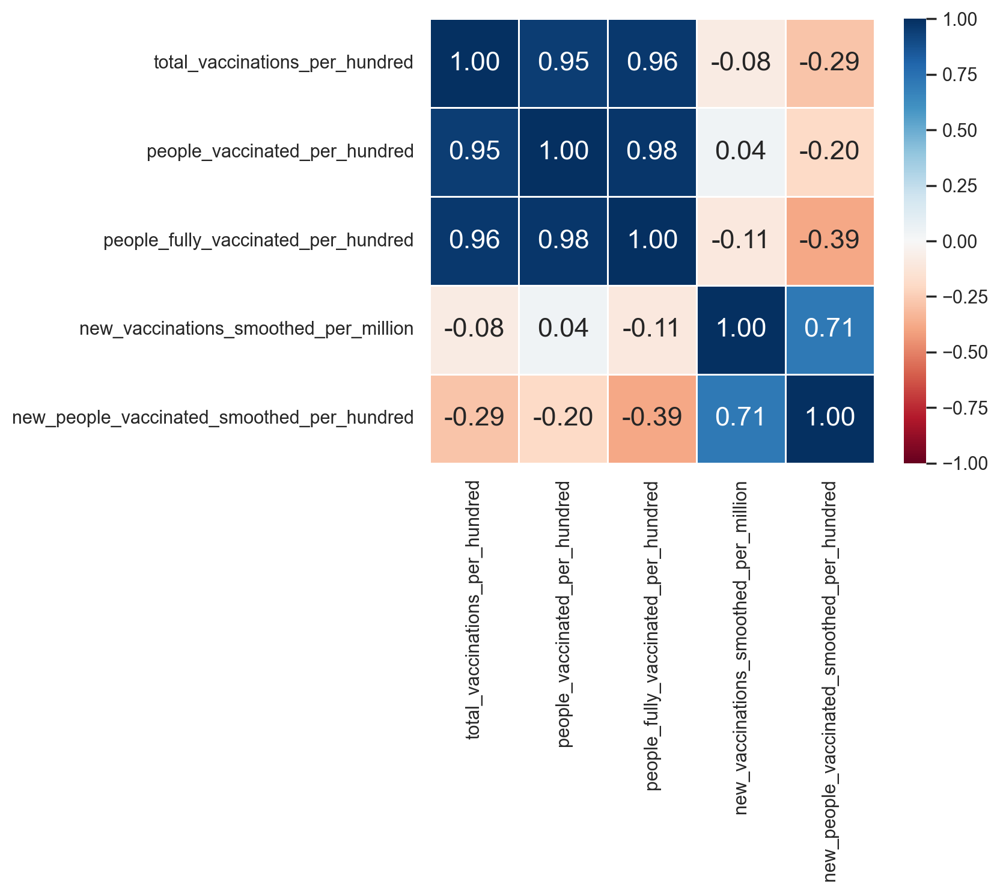

In [9]:
sb.heatmap(vacc_corr, vmin = -1, vmax = 1, linewidths = 1, annot = True,
           fmt = ".2f", annot_kws = {"size":16}, cmap = "RdBu", square=True);

There were strong linear correlations between total vaccinations, number of people vaccinated, and number of people fully vaccinated. As such, it (roughly) did not matter which variable we chose to calculate the correlations with other variables.

The correlation between the number of new vaccinations and the number of new people vaccinated was weaker, favoring once instead of the other could lead to great change in the correlations calculated. We chose the number of new people vaccinated to explore.

In [10]:
identifiers = ['date', 'iso_code', 'location']
developmentIdx = ['gdp_per_capita', 'population_density', 'median_age',
                  'aged_70_older', 'population', 'extreme_poverty',
                  'cardiovasc_death_rate', 'diabetes_prevalence',
                  'female_smokers', 'male_smokers', 'handwashing_facilities',
                  'hospital_beds_per_thousand', 'life_expectancy',
                  'human_development_index']
progressVarToPredict = {'short_term':['new_cases_smoothed_per_million', 'new_deaths_smoothed_per_million'],
                        'long_term':['total_cases_per_million', 'total_deaths_per_million']}
progressPredictor = {'stringency_index':['stringency_index'],
                     'short_term':['new_tests_smoothed_per_thousand', 'new_people_vaccinated_smoothed_per_hundred'],
                     'long_term':['total_tests_per_thousand', 'total_vaccinations_per_hundred']}

In [11]:
devColumns = identifiers + developmentIdx + progressVarToPredict['long_term']
progressColumns = identifiers + [elem for sublist in progressPredictor.values() for elem in sublist] + [elem for sublist in progressVarToPredict.values() for elem in sublist]
print('devColumns are: \t', devColumns)
print('progressColumns:\t', progressColumns)

devColumns are: 	 ['date', 'iso_code', 'location', 'gdp_per_capita', 'population_density', 'median_age', 'aged_70_older', 'population', 'extreme_poverty', 'cardiovasc_death_rate', 'diabetes_prevalence', 'female_smokers', 'male_smokers', 'handwashing_facilities', 'hospital_beds_per_thousand', 'life_expectancy', 'human_development_index', 'total_cases_per_million', 'total_deaths_per_million']
progressColumns:	 ['date', 'iso_code', 'location', 'stringency_index', 'new_tests_smoothed_per_thousand', 'new_people_vaccinated_smoothed_per_hundred', 'total_tests_per_thousand', 'total_vaccinations_per_hundred', 'new_cases_smoothed_per_million', 'new_deaths_smoothed_per_million', 'total_cases_per_million', 'total_deaths_per_million']


In [12]:
covid_df_part1 = covid_df.loc[:, devColumns]
covid_df_part2 = covid_df.loc[:, progressColumns]
covid_df_part1

,date,iso_code,location,gdp_per_capita,population_density,median_age,aged_70_older,population,extreme_poverty,cardiovasc_death_rate,diabetes_prevalence,female_smokers,male_smokers,handwashing_facilities,hospital_beds_per_thousand,life_expectancy,human_development_index,total_cases_per_million,total_deaths_per_million
0,2020-02-24,AFG,Afghanistan,1803.987,54.422,18.6,1.337,41128772.0,NaN,597.029,9.59,NaN,NaN,37.746,0.5,64.83,0.511,0.122,NaN
1,2020-02-25,AFG,Afghanistan,1803.987,54.422,18.6,1.337,41128772.0,NaN,597.029,9.59,NaN,NaN,37.746,0.5,64.83,0.511,0.122,NaN
2,2020-02-26,AFG,Afghanistan,1803.987,54.422,18.6,1.337,41128772.0,NaN,597.029,9.59,NaN,NaN,37.746,0.5,64.83,0.511,0.122,NaN
3,2020-02-27,AFG,Afghanistan,1803.987,54.422,18.6,1.337,41128772.0,NaN,597.029,9.59,NaN,NaN,37.746,0.5,64.83,0.511,0.122,NaN
4,2020-02-28,AFG,Afghanistan,1803.987,54.422,18.6,1.337,41128772.0,NaN,597.029,9.59,NaN,NaN,37.746,0.5,64.83,0.511,0.122,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
260331,2023-02-22,ZWE,Zimbabwe,1899.775,42.729,19.6,1.882,16320539.0,21.4,307.846,1.82,1.6,30.7,36.791,1.7,61.49,0.571,16171.096,346.986
260332,2023-02-23,ZWE,Zimbabwe,1899.775,42.729,19.6,1.882,16320539.0,21.4,307.846,1.82,1.6,30.7,36.791,1.7,61.49,0.571,16171.096,346.986
260333,2023-02-24,ZWE,Zimbabwe,1899.775,42.729,19.6,1.882,16320539.0,21.4,307.846,1.82,1.6,30.7,36.791,1.7,61.49,0.571,16171.096,346.986
260334,2023-02-25,ZWE,Zimbabwe,1899.775,42.729,19.6,1.882,16320539.0,21.4,307.846,1.82,1.6,30.7,36.791,1.7,61.49,0.571,16171.096,346.986


In [13]:
covid_df_part2

,date,iso_code,location,stringency_index,new_tests_smoothed_per_thousand,new_people_vaccinated_smoothed_per_hundred,total_tests_per_thousand,total_vaccinations_per_hundred,new_cases_smoothed_per_million,new_deaths_smoothed_per_million,total_cases_per_million,total_deaths_per_million
0,2020-02-24,AFG,Afghanistan,8.33,NaN,NaN,NaN,NaN,NaN,NaN,0.122,NaN
1,2020-02-25,AFG,Afghanistan,8.33,NaN,NaN,NaN,NaN,NaN,NaN,0.122,NaN
2,2020-02-26,AFG,Afghanistan,8.33,NaN,NaN,NaN,NaN,NaN,NaN,0.122,NaN
3,2020-02-27,AFG,Afghanistan,8.33,NaN,NaN,NaN,NaN,NaN,NaN,0.122,NaN
4,2020-02-28,AFG,Afghanistan,8.33,NaN,NaN,NaN,NaN,NaN,NaN,0.122,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...
260331,2023-02-22,ZWE,Zimbabwe,NaN,NaN,NaN,NaN,NaN,2.442,0.009,16171.096,346.986
260332,2023-02-23,ZWE,Zimbabwe,NaN,NaN,NaN,NaN,NaN,NaN,0.009,16171.096,346.986
260333,2023-02-24,ZWE,Zimbabwe,NaN,NaN,NaN,NaN,NaN,NaN,0.009,16171.096,346.986
260334,2023-02-25,ZWE,Zimbabwe,NaN,NaN,NaN,NaN,NaN,NaN,0.009,16171.096,346.986


## Effect of development level

The development level of a country are represented by these indices:
```python
'population'
'population_density'
'median_age'
'aged_70_older'
'gdp_per_capita'
'extreme_poverty'
'cardiovasc_death_rate'
'diabetes_prevalence'
'female_smokers'
'male_smokers'
'handwashing_facilities'
'hospital_beds_per_thousand'
'life_expectancy'
'human_development_index'
```
These indices were not updated with time (the authors took the latest available from official sources). However, one may expect some (e.g. `handwashing_facilities`) to increase with time amid the pandemic. Let's plotting them against time to check first.

In [14]:
covid_df_part1.describe(include='all', datetime_is_numeric=True)

,date,iso_code,location,gdp_per_capita,population_density,median_age,aged_70_older,population,extreme_poverty,cardiovasc_death_rate,diabetes_prevalence,female_smokers,male_smokers,handwashing_facilities,hospital_beds_per_thousand,life_expectancy,human_development_index,total_cases_per_million,total_deaths_per_million
count,260336,260336,260336,209578.000000,226931.000000,209793.000000,208696.000000,2.592200e+05,136432.000000,209165.000000,220202.000000,158696.000000,156525.000000,103210.000000,186556.000000,238957.000000,204525.000000,244680.000000,224992.000000
unique,NaN,248,248,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
top,NaN,ARG,Argentina,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
freq,NaN,1153,1153,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
mean,2021-09-05 04:08:53.218609664,NaN,NaN,19494.810546,455.550663,30.580780,5.539003,1.405129e+08,13.660306,261.818623,8.395172,10.689225,32.821496,50.892582,3.089077,73.596502,0.724523,74449.333899,757.053891
min,2020-01-01 00:00:00,NaN,NaN,661.240000,0.137000,15.100000,0.526000,4.700000e+01,0.100000,79.370000,0.990000,0.100000,7.700000,1.188000,0.100000,53.280000,0.394000,0.001000,0.000000
25%,2020-12-12 00:00:00,NaN,NaN,4449.898000,37.312000,22.300000,2.063000,8.367830e+05,0.600000,170.050000,5.310000,1.900000,21.600000,20.859000,1.300000,69.500000,0.602000,1395.518000,34.725000
50%,2021-09-10 00:00:00,NaN,NaN,12951.839000,87.324000,29.900000,4.032000,6.948395e+06,2.200000,243.964000,7.200000,6.300000,33.100000,49.839000,2.500000,75.050000,0.742000,14134.632000,252.262500
75%,2022-06-01 00:00:00,NaN,NaN,27717.847000,214.243000,39.100000,8.678000,3.369661e+07,21.400000,329.942000,10.590000,19.300000,41.300000,83.241000,4.200000,79.070000,0.838000,88588.833000,1145.905500
max,2023-02-26 00:00:00,NaN,NaN,116935.600000,20546.766000,48.200000,18.493000,7.975105e+09,77.600000,724.417000,30.530000,44.000000,78.100000,100.000000,13.800000,86.750000,0.957000,724428.492000,6443.720000


In [15]:
covid_df_part1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 260336 entries, 0 to 260335
Data columns (total 19 columns):
 #   Column                      Non-Null Count   Dtype         
---  ------                      --------------   -----         
 0   date                        260336 non-null  datetime64[ns]
 1   iso_code                    260336 non-null  object        
 2   location                    260336 non-null  object        
 3   gdp_per_capita              209578 non-null  float64       
 4   population_density          226931 non-null  float64       
 5   median_age                  209793 non-null  float64       
 6   aged_70_older               208696 non-null  float64       
 7   population                  259220 non-null  float64       
 8   extreme_poverty             136432 non-null  float64       
 9   cardiovasc_death_rate       209165 non-null  float64       
 10  diabetes_prevalence         220202 non-null  float64       
 11  female_smokers              158696 non-

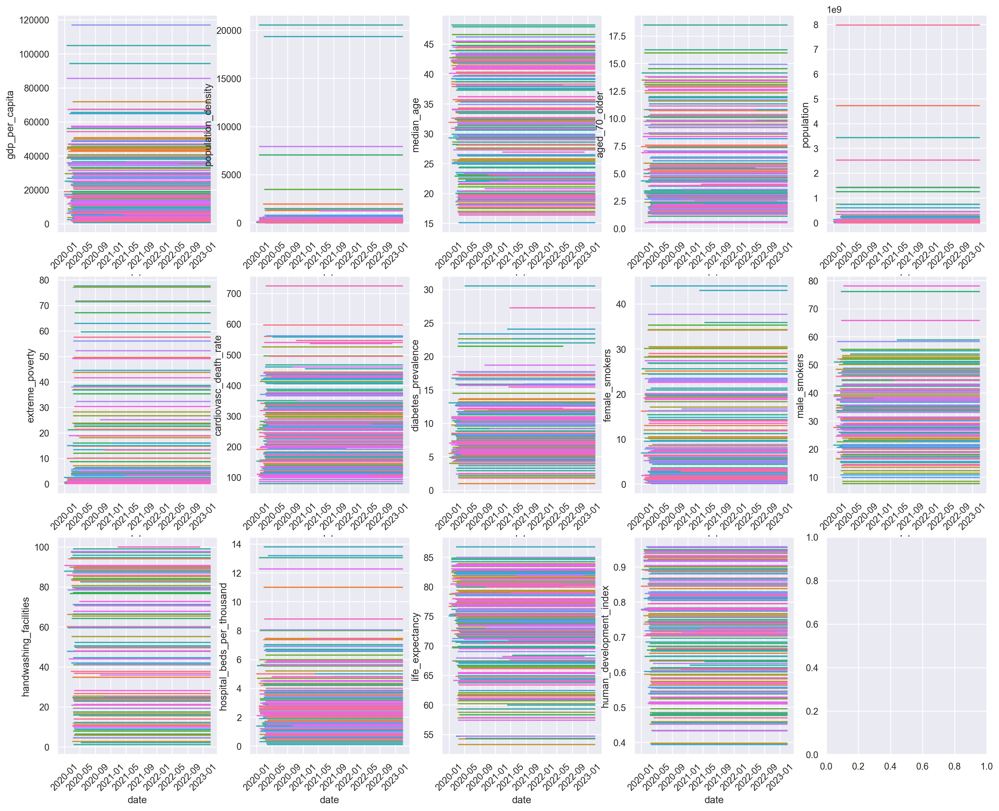

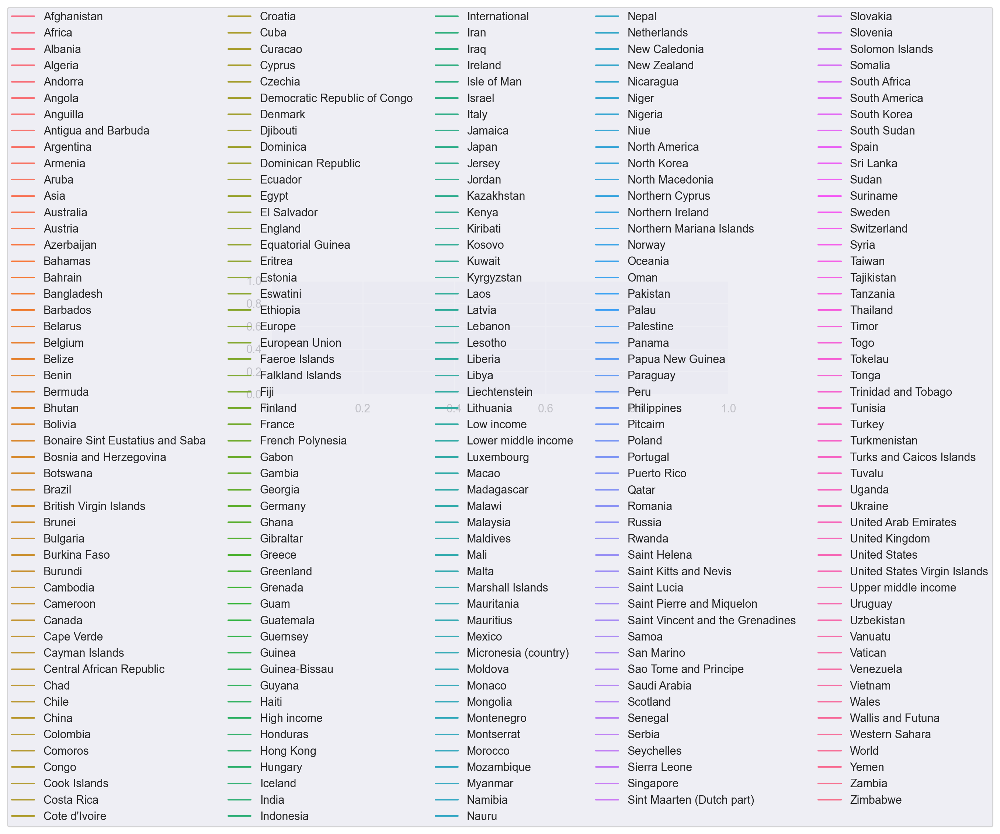

In [16]:
# Checking indices dependence on time
row = col = 0
_, ax = plt.subplots(3, 5, figsize=(20,16))
for index in developmentIdx:
    sb.lineplot(data=covid_df_part1, x='date', y=index, hue='location', ax=ax[row][col]);
    plt.sca(ax[row][col])
    ax[row][col].get_legend().remove()
    plt.xticks(rotation=45)
    col += 1
    if col > 4:
        row += 1
        col = 0
# Create a separate legend figure and adjust its position
fig_legend = plt.figure(figsize=(8, 2))
ax_legend = fig_legend.add_subplot(111)
ax_legend.legend(*ax[0][0].get_legend_handles_labels(), loc='center', ncol=5, bbox_to_anchor=(0.5, -0.2))

# Show the plot and the legend
plt.show()

The output was messy, but just as expected, these development indices do not depend on time. It means that we can take just one data column for each country for exploration. Let's take the latest date. The full codes to do so is describe [here](https://stackoverflow.com/questions/20067636/pandas-dataframe-get-first-row-of-each-group).


In [17]:
covid_df_part1 = covid_df_part1.groupby('location').nth(-1).reset_index()
covid_df_part1

,location,date,iso_code,gdp_per_capita,population_density,median_age,aged_70_older,population,extreme_poverty,cardiovasc_death_rate,diabetes_prevalence,female_smokers,male_smokers,handwashing_facilities,hospital_beds_per_thousand,life_expectancy,human_development_index,total_cases_per_million,total_deaths_per_million
0,Afghanistan,2023-02-26,AFG,1803.987,54.422,18.6,1.337,4.112877e+07,NaN,597.029,9.59,NaN,NaN,37.746,0.500,64.83,0.511,5088.263,191.982
1,Africa,2023-02-26,OWID_AFR,NaN,NaN,NaN,NaN,1.426737e+09,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,8772.223,180.600
2,Albania,2023-02-26,ALB,11803.431,104.871,38.0,8.643,2.842318e+06,1.1,304.195,10.08,7.100,51.200,NaN,2.890,78.57,0.795,117642.713,1265.868
3,Algeria,2023-02-26,DZA,13913.839,17.348,29.1,3.857,4.490323e+07,0.5,278.364,6.73,0.700,30.400,83.741,1.900,76.88,0.748,6045.000,153.241
4,Andorra,2023-02-26,AND,NaN,163.755,NaN,NaN,7.984300e+04,NaN,109.135,7.97,29.000,37.800,NaN,NaN,83.73,0.868,599501.522,2066.556
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
243,Western Sahara,2022-04-20,ESH,NaN,NaN,28.4,1.380,5.760050e+05,NaN,NaN,NaN,NaN,NaN,NaN,NaN,70.26,NaN,NaN,NaN
244,World,2023-02-26,OWID_WRL,15469.207,58.045,30.9,5.355,7.975105e+09,10.0,233.070,8.51,6.434,34.635,60.130,2.705,72.58,0.737,84630.022,861.432
245,Yemen,2023-02-26,YEM,1479.147,53.508,20.3,1.583,3.369661e+07,18.8,495.003,5.35,7.600,29.200,49.542,0.700,66.12,0.470,354.487,64.072
246,Zambia,2023-02-26,ZMB,3689.251,22.995,17.7,1.542,2.001767e+07,57.5,234.499,3.94,3.100,24.700,13.938,2.000,63.89,0.584,17126.419,202.571


In [18]:
covid_df_part1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 248 entries, 0 to 247
Data columns (total 19 columns):
 #   Column                      Non-Null Count  Dtype         
---  ------                      --------------  -----         
 0   location                    248 non-null    object        
 1   date                        248 non-null    datetime64[ns]
 2   iso_code                    248 non-null    object        
 3   gdp_per_capita              196 non-null    float64       
 4   population_density          213 non-null    float64       
 5   median_age                  196 non-null    float64       
 6   aged_70_older               195 non-null    float64       
 7   population                  247 non-null    float64       
 8   extreme_poverty             126 non-null    float64       
 9   cardiovasc_death_rate       195 non-null    float64       
 10  diabetes_prevalence         206 non-null    float64       
 11  female_smokers              147 non-null    float64       

We have a bunch of `NaN` values here. Dealing with `NaN` values (called "imputation") is a lengthy subject with solution ranging from simple (drop, uniformly replace with mean/mode/etc.) to complex (KNN, MICE, etc.). For the case at hand, considering we have a total of 248 countries or representations in the dataset (you notice that there were continent-level values such as World or Africa in the `DataFrame`), simply dropping would mean losing too much data (reduced to 96 data points only). Hence, we will impute the data. Among the technique, let's choose MICE (Multiple Imputation by Chained Equation), a complex but robust technique and readily packaged in `sklearn.impute.IterativeImputer`. We will compare that with imputation by mean of `sklearn.impute.SimpleImputer` when we calculate the correlations.

In [19]:
MICE_imputer, mean_imputer = IterativeImputer(), SimpleImputer()
subset = covid_df_part1.iloc[:, 3:]
MICE_subset, mean_subset = (MICE_imputer.fit_transform(subset),
                            mean_imputer.fit_transform(subset))
MICE_sub_df, mean_sub_df = (pd.DataFrame(data=MICE_subset, columns=devColumns[3:]),
                            pd.DataFrame(data=mean_subset, columns=devColumns[3:]))
print('MICE_sub_df: \n')
MICE_sub_df

MICE_sub_df: 



,gdp_per_capita,population_density,median_age,aged_70_older,population,extreme_poverty,cardiovasc_death_rate,diabetes_prevalence,female_smokers,male_smokers,handwashing_facilities,hospital_beds_per_thousand,life_expectancy,human_development_index,total_cases_per_million,total_deaths_per_million
0,1803.987000,54.422000,18.600000,1.337000,4.112877e+07,26.534072,597.029000,9.590000,3.576450,46.131785,37.746000,0.500000,64.830000,0.511000,5088.263000,191.982000
1,10661.097198,516.143734,28.673771,4.884832,1.426737e+09,15.170995,287.530051,8.389652,2.767093,32.350665,54.834707,2.832758,71.097834,0.671716,8772.223000,180.600000
2,11803.431000,104.871000,38.000000,8.643000,2.842318e+06,1.100000,304.195000,10.080000,7.100000,51.200000,87.058357,2.890000,78.570000,0.795000,117642.713000,1265.868000
3,13913.839000,17.348000,29.100000,3.857000,4.490323e+07,0.500000,278.364000,6.730000,0.700000,30.400000,83.741000,1.900000,76.880000,0.748000,6045.000000,153.241000
4,46411.294577,163.755000,34.620396,9.202640,7.984300e+04,-1.702086,109.135000,7.970000,29.000000,37.800000,128.757544,3.793661,83.730000,0.868000,599501.522000,2066.556000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
243,20818.604822,439.157824,28.400000,1.380000,5.760050e+05,11.105863,273.165078,8.599654,10.427315,33.790883,73.399657,2.560083,70.260000,0.705777,190958.617128,1278.449663
244,15469.207000,58.045000,30.900000,5.355000,7.975105e+09,10.000000,233.070000,8.510000,6.434000,34.635000,60.130000,2.705000,72.580000,0.737000,84630.022000,861.432000
245,1479.147000,53.508000,20.300000,1.583000,3.369661e+07,18.800000,495.003000,5.350000,7.600000,29.200000,49.542000,0.700000,66.120000,0.470000,354.487000,64.072000
246,3689.251000,22.995000,17.700000,1.542000,2.001767e+07,57.500000,234.499000,3.940000,3.100000,24.700000,13.938000,2.000000,63.890000,0.584000,17126.419000,202.571000


In [20]:
print('mean_sub_df: \n')
mean_sub_df

mean_sub_df: 



,gdp_per_capita,population_density,median_age,aged_70_older,population,extreme_poverty,cardiovasc_death_rate,diabetes_prevalence,female_smokers,male_smokers,handwashing_facilities,hospital_beds_per_thousand,life_expectancy,human_development_index,total_cases_per_million,total_deaths_per_million
0,1803.987000,54.422000,18.60000,1.337,4.112877e+07,13.848413,597.029000,9.590000,10.790027,32.909897,37.746000,0.500000,64.830000,0.5110,5088.263000,191.982000
1,19173.612255,445.075108,30.42602,5.464,1.426737e+09,13.848413,264.167708,8.561068,10.790027,32.909897,50.788844,3.097012,73.525242,0.7225,8772.223000,180.600000
2,11803.431000,104.871000,38.00000,8.643,2.842318e+06,1.100000,304.195000,10.080000,7.100000,51.200000,50.788844,2.890000,78.570000,0.7950,117642.713000,1265.868000
3,13913.839000,17.348000,29.10000,3.857,4.490323e+07,0.500000,278.364000,6.730000,0.700000,30.400000,83.741000,1.900000,76.880000,0.7480,6045.000000,153.241000
4,19173.612255,163.755000,30.42602,5.464,7.984300e+04,13.848413,109.135000,7.970000,29.000000,37.800000,50.788844,3.097012,83.730000,0.8680,599501.522000,2066.556000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
243,19173.612255,445.075108,28.40000,1.380,5.760050e+05,13.848413,264.167708,8.561068,10.790027,32.909897,50.788844,3.097012,70.260000,0.7225,187406.000504,1258.171425
244,15469.207000,58.045000,30.90000,5.355,7.975105e+09,10.000000,233.070000,8.510000,6.434000,34.635000,60.130000,2.705000,72.580000,0.7370,84630.022000,861.432000
245,1479.147000,53.508000,20.30000,1.583,3.369661e+07,18.800000,495.003000,5.350000,7.600000,29.200000,49.542000,0.700000,66.120000,0.4700,354.487000,64.072000
246,3689.251000,22.995000,17.70000,1.542,2.001767e+07,57.500000,234.499000,3.940000,3.100000,24.700000,13.938000,2.000000,63.890000,0.5840,17126.419000,202.571000


In [21]:
print("mean_sub_df info:")
mean_sub_df.info()

print("\nMICE_sub_df info:")
MICE_sub_df.info()

mean_sub_df info:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 248 entries, 0 to 247
Data columns (total 16 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   gdp_per_capita              248 non-null    float64
 1   population_density          248 non-null    float64
 2   median_age                  248 non-null    float64
 3   aged_70_older               248 non-null    float64
 4   population                  248 non-null    float64
 5   extreme_poverty             248 non-null    float64
 6   cardiovasc_death_rate       248 non-null    float64
 7   diabetes_prevalence         248 non-null    float64
 8   female_smokers              248 non-null    float64
 9   male_smokers                248 non-null    float64
 10  handwashing_facilities      248 non-null    float64
 11  hospital_beds_per_thousand  248 non-null    float64
 12  life_expectancy             248 non-null    float64
 13  human_development

Totally imputed. A better way would be to consult official data from another official source for the missing values. We were limited by the scope of the project (and time), so we did not compare the result from MICE to official ones, (though some problematic values ould be seen right away, such as the handwashing facilities of Andorra)

Let's check the correlations between the development indices.

In [22]:
# Create the first pair plot
plt.figure();
sb.pairplot(mean_sub_df);
plt.title("Pair plot of mean_sub_df")

# Stack the pairplots vertically instead of horizontally
plt.subplots_adjust(hspace=0.5)

# Create the second pair plot
plt.figure();
sb.pairplot(MICE_sub_df);
plt.title("Pair plot of MICE_sub_df")

# Show both plots
plt.show()

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

The `pairplot` for this case is too big. Let's check to see if `heatmap` can yield something more manageable. (For anyone wondering, the titles have been pushed off to the bottom corner of the pairplot)

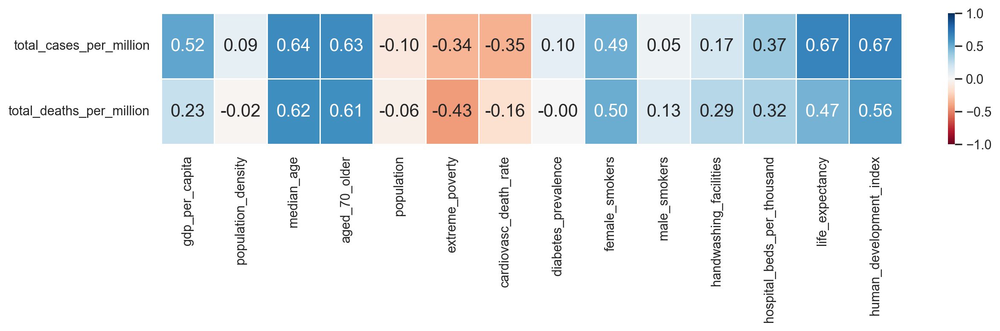

In [23]:
mean_corr_score = mean_sub_df.corr()
plt.figure(figsize=(14, 2))
sb.heatmap(mean_corr_score.loc[progressVarToPredict['long_term'], developmentIdx], vmin = -1, vmax = 1, linewidths = 1,
           annot = True, fmt = ".2f", annot_kws = {"size":15}, cmap = "RdBu");

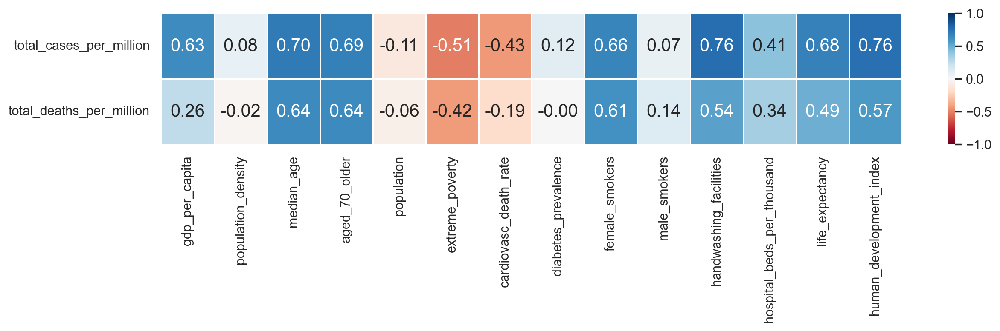

In [24]:
MICE_corr_score = MICE_sub_df.corr()
plt.figure(figsize=(14, 2))
sb.heatmap(MICE_corr_score.loc[progressVarToPredict['long_term'], developmentIdx], vmin = -1, vmax = 1, linewidths = 1,
           annot = True, fmt = ".2f", annot_kws = {"size":15}, cmap = "RdBu");

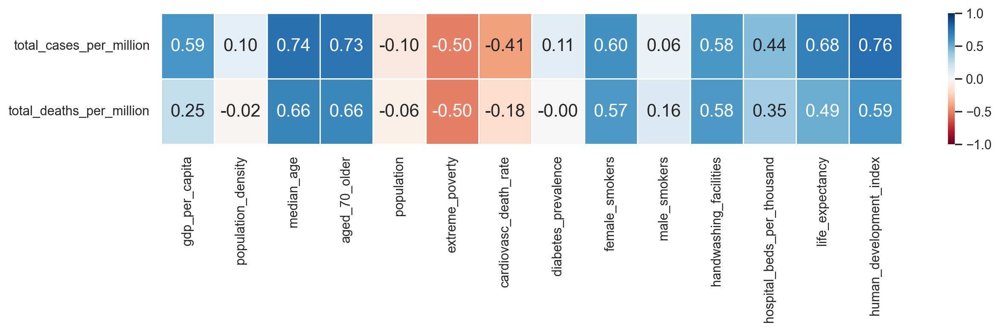

In [25]:
# Original correlations
corr_1 = covid_df_part1.iloc[:, 3:].corr()
plt.figure(figsize=(14, 2))
sb.heatmap(corr_1.loc[progressVarToPredict['long_term'], developmentIdx], vmin = -1, vmax = 1, linewidths = 1,
           annot = True, fmt = ".2f", annot_kws = {"size":15}, cmap = "RdBu");

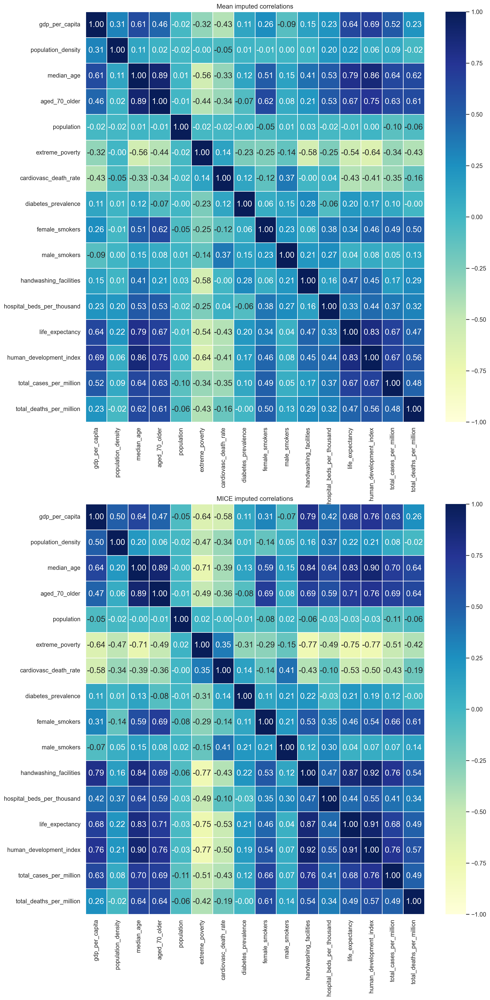

In [26]:
# Full heatmap
_, ax = plt.subplots(nrows=2, ncols=1, figsize=(14, 30))
sb.heatmap(mean_corr_score, vmin = -1, vmax = 1, linewidths = 1,
           annot = True, fmt = ".2f", annot_kws = {"size":15}, cmap = "YlGnBu", ax=ax[0]);
sb.heatmap(MICE_corr_score, vmin = -1, vmax = 1, linewidths = 1,
           annot = True, fmt = ".2f", annot_kws = {"size":15}, cmap = "YlGnBu", ax=ax[1]);
ax[0].set_title("Mean imputed correlations");
ax[1].set_title("MICE imputed correlations");

For the MICE-imputed `DataFrame`, over the long run, it seems that factors strongly to moderately correlated with total COVID cases included: Human Development Index, number of handwashing facilities, median age of population, percentage of population 70 years old or older, life expectancy, percentage of female smokers, GDP per capita, and the rate of extreme poverty. The effect of every case was weaker on total COVID deaths.

One immediate thing to note is the correlations for MICE-imputed `DataFrame` were generally higher in value compared to those of the mean-imputed `DataFrame`. The biggest difference was observed between number of handwashing facilities and total cases, of $0.17$ for mean-imputed and $0.76$ for MICE-imputed.

An interesting trend was the positive correlation between GDP per capita/Human Development Index and total number of cases. Both indices represent the level of financial and human development of a country, so one would expect negative correlations i.e., more countries had less cases, but that seemed to be not the case. 

Let's plot the values for visualization

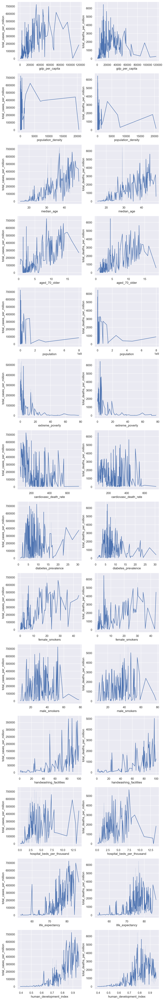

In [27]:
row = col = 0
_, ax = plt.subplots(len(developmentIdx), len(progressVarToPredict['long_term']), figsize=(10,70))
for development_index in developmentIdx:
    for long_term_index in progressVarToPredict['long_term']:
        sb.lineplot(data=mean_sub_df, x=development_index, y=long_term_index, ax=ax[row][col]);
        col += 1
    col = 0
    row += 1
plt.show()

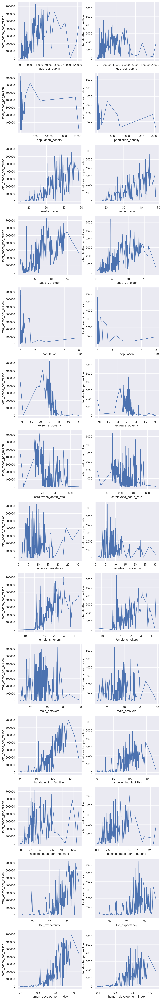

In [28]:
row = col = 0
_, ax = plt.subplots(len(developmentIdx), len(progressVarToPredict['long_term']), figsize=(10,70))
for development_index in developmentIdx:
    for long_term_index in progressVarToPredict['long_term']:
        sb.lineplot(data=MICE_sub_df, x=development_index, y=long_term_index, ax=ax[row][col]);
        col += 1
    col = 0
    row += 1
plt.show()

## COVID progress

A first visualization of the data.

In [29]:
print('The time series columns of covid_df_part2 is: \t', progressColumns[3:])
print('The length is: \t', len(progressColumns[3:]))

The time series columns of covid_df_part2 is: 	 ['stringency_index', 'new_tests_smoothed_per_thousand', 'new_people_vaccinated_smoothed_per_hundred', 'total_tests_per_thousand', 'total_vaccinations_per_hundred', 'new_cases_smoothed_per_million', 'new_deaths_smoothed_per_million', 'total_cases_per_million', 'total_deaths_per_million']
The length is: 	 9


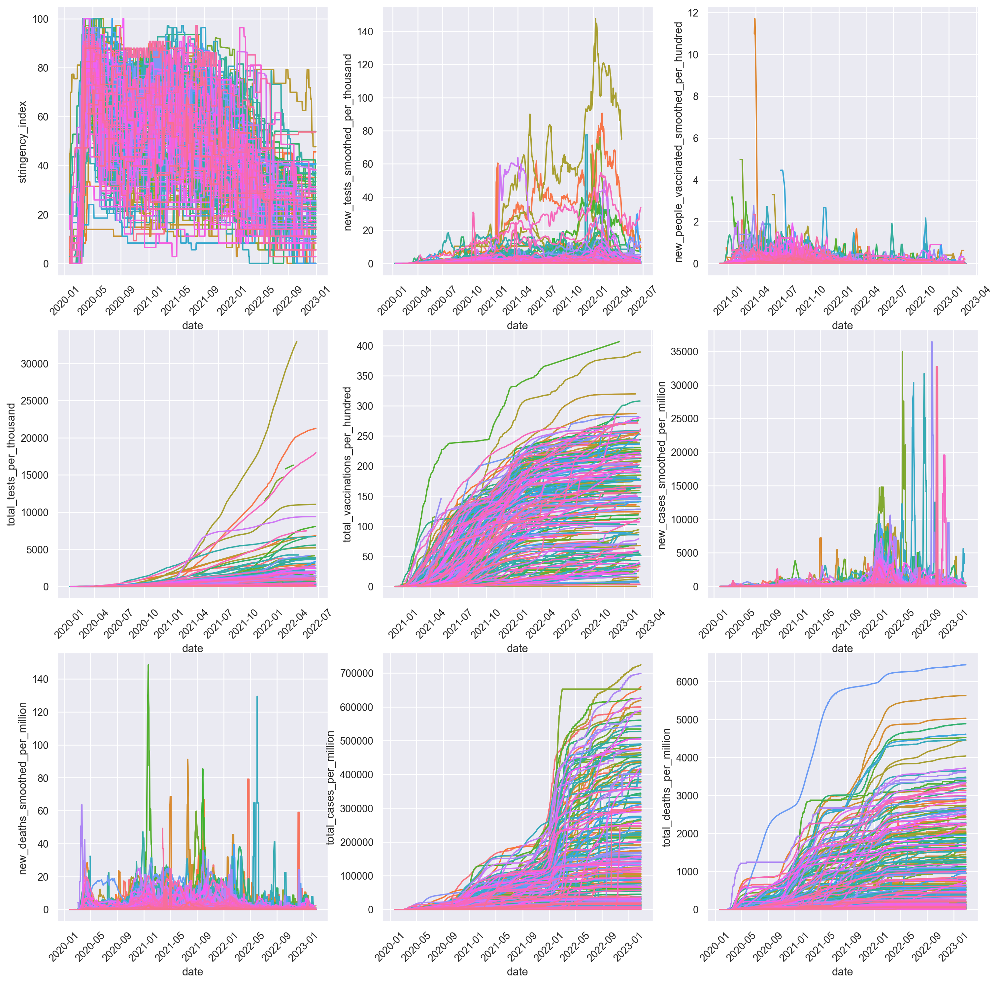

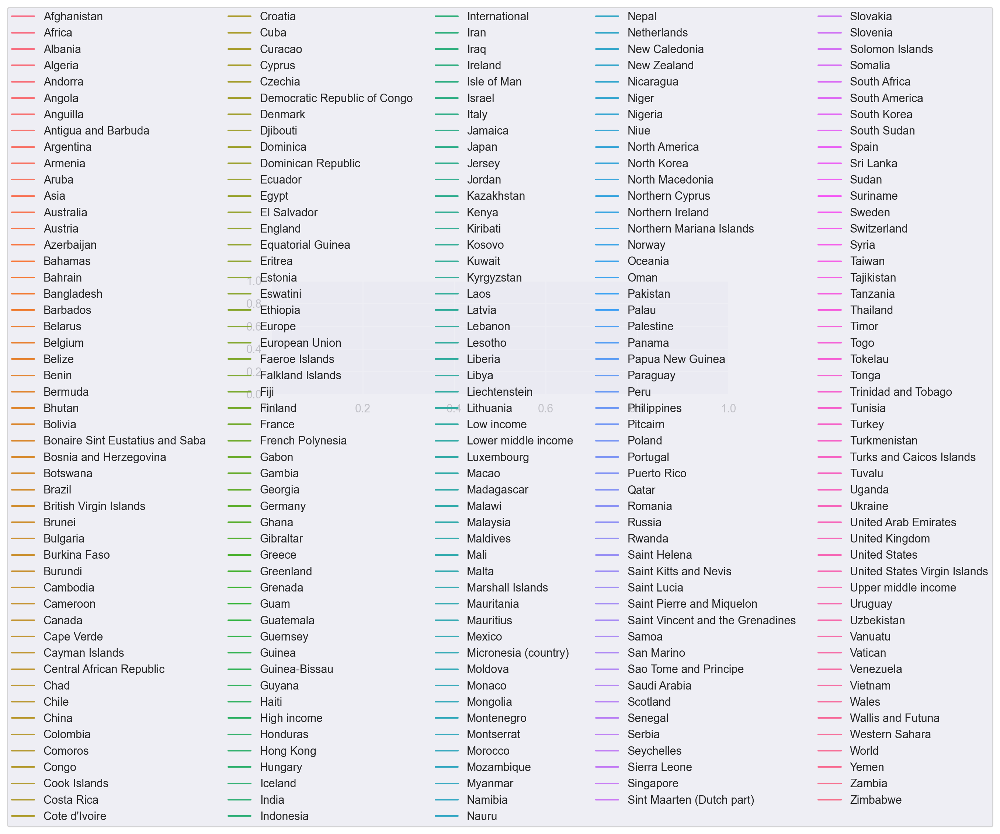

In [30]:
# Checking indices dependence on time
row = col = 0
_, ax = plt.subplots(3, 3, figsize=(18,18))
for index in progressColumns[3:]:
    sb.lineplot(data=covid_df_part2, x='date', y=index, hue='location', ax=ax[row][col]);
    plt.sca(ax[row][col])
    ax[row][col].get_legend().remove()
    plt.xticks(rotation=45)
    col += 1
    if col > 2:
        row += 1
        col = 0
# Create a separate legend figure and adjust its position
fig_legend = plt.figure(figsize=(8, 2))
ax_legend = fig_legend.add_subplot(111)
ax_legend.legend(*ax[0][0].get_legend_handles_labels(), loc='center', ncol=5, bbox_to_anchor=(0.5, -0.2))

# Show the plot and the legend
plt.show()

As above, the visualization is totally incomprehensible. There were definitely some spikes here and there, but it is indecipherable which shade of blue or green. It would be better if we separate the countries into batches.

```python
identifiers = ['date', 'iso_code', 'location']
developmentIdx = ['gdp_per_capita', 'population_density', 'median_age',
                  'aged_70_older', 'population', 'extreme_poverty',
                  'cardiovasc_death_rate', 'diabetes_prevalence',
                  'female_smokers', 'male_smokers', 'handwashing_facilities',
                  'hospital_beds_per_thousand', 'life_expectancy',
                  'human_development_index']
progressVarToPredict = {'short_term':['new_cases_smoothed_per_million', 'new_deaths_smoothed_per_million'],
                        'long_term':['total_cases_per_million', 'total_deaths_per_million']}
progressPredictor = {'stringency_index':['stringency_index'],
                     'short_term':['new_tests_smoothed_per_thousand', 'new_vaccinations_smoothed_per_million'],
                     'long_term':['total_tests_per_thousand', 'total_vaccinations_per_hundred']}
```
```python
devColumns are: 	 ['date', 'iso_code', 'location', 'gdp_per_capita', 'population_density', 'median_age', 'aged_70_older', 'population', 'extreme_poverty', 'cardiovasc_death_rate', 'diabetes_prevalence', 'female_smokers', 'male_smokers', 'handwashing_facilities', 'hospital_beds_per_thousand', 'life_expectancy', 'human_development_index', 'total_cases_per_million', 'total_deaths_per_million']
progressColumns:	 ['date', 'iso_code', 'location', 'stringency_index', 'new_tests_smoothed_per_thousand', 'new_vaccinations_smoothed_per_million', 'total_tests_per_thousand', 'total_vaccinations_per_hundred', 'new_cases_smoothed_per_million', 'new_deaths_smoothed_per_million', 'total_cases_per_million', 'total_deaths_per_million']
```

In [31]:
covid_df_part2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 260336 entries, 0 to 260335
Data columns (total 12 columns):
 #   Column                                      Non-Null Count   Dtype         
---  ------                                      --------------   -----         
 0   date                                        260336 non-null  datetime64[ns]
 1   iso_code                                    260336 non-null  object        
 2   location                                    260336 non-null  object        
 3   stringency_index                            185194 non-null  float64       
 4   new_tests_smoothed_per_thousand             103965 non-null  float64       
 5   new_people_vaccinated_smoothed_per_hundred  156584 non-null  float64       
 6   total_tests_per_thousand                    79387 non-null   float64       
 7   total_vaccinations_per_hundred              72726 non-null   float64       
 8   new_cases_smoothed_per_million              243141 non-null  float64      

The missing values were due to vaccinations/tests/cases/deaths not reported, so should be filled with 0.

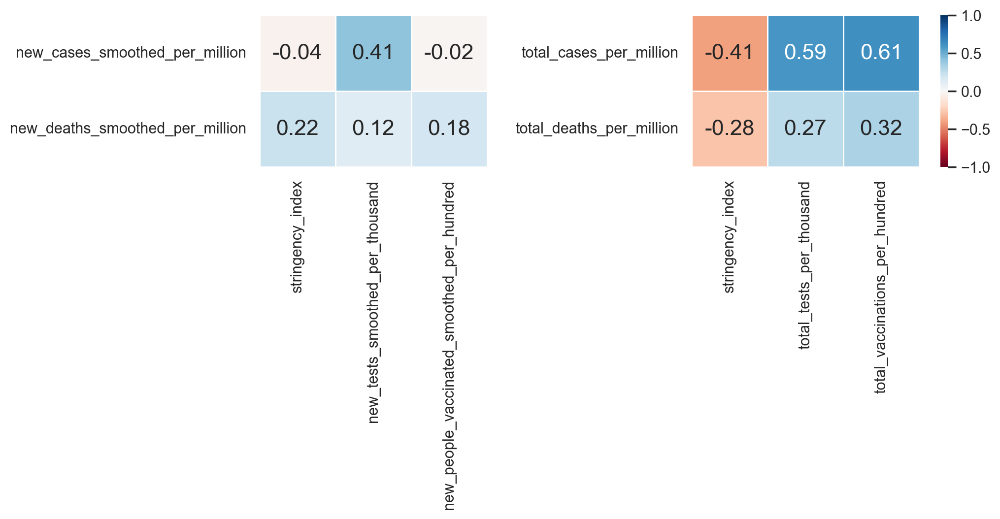

In [32]:
corr_2 = covid_df_part2.iloc[:,3:].corr()

_, ax = plt.subplots(1, 2, figsize=(11, 2))
sb.heatmap(corr_2.loc[progressColumns[8:10], progressColumns[3:6]], vmin = -1, vmax = 1, linewidths = 1,
           annot = True, fmt = ".2f", annot_kws = {"size":16}, cmap = "RdBu", ax=ax[0], square=True, cbar=False)
sb.heatmap(corr_2.loc[progressColumns[10:], progressColumns[3:4]+progressColumns[6:8]], vmin = -1, vmax = 1, linewidths = 1,
           annot = True, fmt = ".2f", annot_kws = {"size":16}, cmap = "RdBu", ax=ax[1], square=True)
# Set the aspect ratio of the Axes objects
for i in range(len(ax)):
    ax[i].set_aspect('equal')
# Adjust the subplots layout
plt.subplots_adjust(wspace=0)

plt.show()

In [33]:
covid_df_part2.fillna(0, inplace=True)

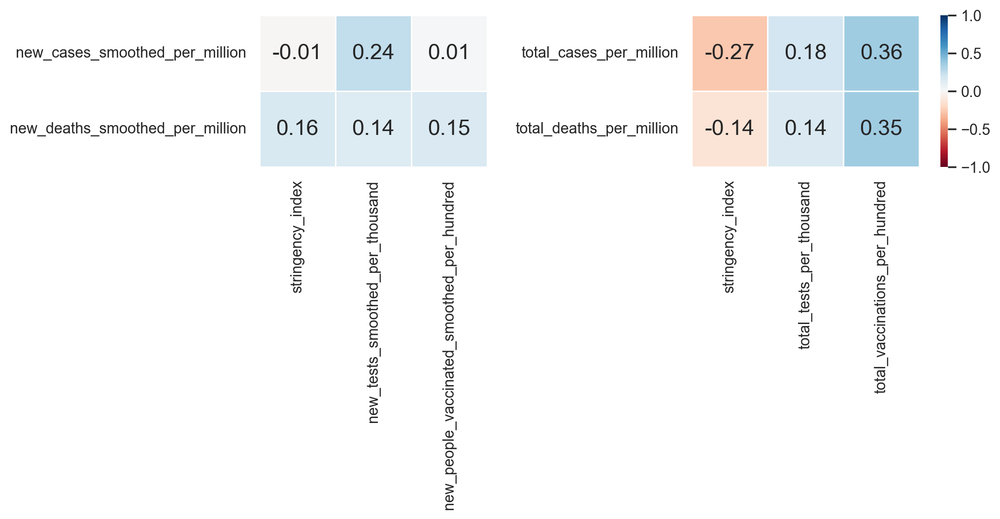

In [34]:
corr_2 = covid_df_part2.iloc[:,3:].corr()

_, ax = plt.subplots(1, 2, figsize=(11, 2))
sb.heatmap(corr_2.loc[progressColumns[8:10], progressColumns[3:6]], vmin = -1, vmax = 1, linewidths = 1,
           annot = True, fmt = ".2f", annot_kws = {"size":16}, cmap = "RdBu", ax=ax[0], square=True, cbar=False)
sb.heatmap(corr_2.loc[progressColumns[10:], progressColumns[3:4]+progressColumns[6:8]], vmin = -1, vmax = 1, linewidths = 1,
           annot = True, fmt = ".2f", annot_kws = {"size":16}, cmap = "RdBu", ax=ax[1], square=True)
# Set the aspect ratio of the Axes objects
for i in range(len(ax)):
    ax[i].set_aspect('equal')
# Adjust the subplots layout
plt.subplots_adjust(wspace=0)

plt.show()

## Machine Learning

Based on above understanding of the data which we achieved through exploratory analysis, pattern recognision and visualisation of data, we now have an understanding of how different variables affect how new_cases. Prediction of new_cases for covid is a complicated problem; there are many variables that are interconnected and influence development of new_cases. 

For example, our understanding of COVID_19 outside the data provides us with an additional insight of how patients who do develop COVID-19 only display symptoms of COVID after the incubation period, which mostly varies from 2-14 days, which also influence how new_cases would develop. Based on the time frame at which data is taken, we also note variances in the stringency indices, vaccination rates as vaccination becomes more accesible which varies in time frame across different nations and even within nations based on location approximate to city center. 

These variables complicate prediction of new_cases: these variables are required to accurately predict how new_cases develop, hence prediction of new_cases involves the adoption of a model that can deal with the multivariate nature of COVID-19. 

As we wish to predict new_cases using data that has been obtained over the spike period in a time period, extrapolation of data that falls outside the training set has to be done. In this way, regression model serves a suitable method which this can be carried out. However, due to the complex nature of COVID-19 pandemic as we have discussed above, it would be a very likely scenario that noise, outliers and the assumption of linearity between dependent and independent variables would affect the accuracy of the model.

The approach for developing a suitable machine learning model would first to explore different models on the data that has been collected, and use a time-based train/test split. Based on the models, we would then select the most suitable machine learning model for regression.

In consideration of the aforementioned problems of this implementation, we would then incorporate the use of classification models to further improve our model. This would be done by means of a stacked regression method where estimators are blended to improve overall performance. 



Our data science problem is : Machine Learning on the dataset in the spike period, predict the number of new cases/deaths in a time period (e.g. 3 weeks) based on information about the countries

To achieve these objective, we shall use Linear Regression and Classification Tree approaches that have been taught in class. As linear regression as a model may not be fully effective due to many different factors that impact the numbers of new cases/deaths in a time period, the approach alone may not be completely effective in predicting new cases/deaths when factors change. As a result, Classification Tree is used in tandem to create a more robust model. 

Based on the above, we shall adopt Gradient Boosting ensemble model where decision trees are used to make predictions but each tree is trained usch that residual error of the previous tree is minimised.

To carry out the above model, preparation of data is required. This will require cleaning, handling missing values, and transformation. As the model will be based on time series forecasting, data will be split into training and test set (representing the future time period to be predicted). Data cleaning has already been previously done.

Model will then be defined by specifiying parameters for the Gradient Boosting model, which would include the number of decision trees, depth of trees and learning rate.

The model will then be trained using iterative approaches to add a new decision tree, with each iteration adding a new decision tree to improve overall accuracy.

The model would thne be validated using test test for evaluation of performance by means of an appropriate evaluation metric. Mean squared error, mean absolute error or root mean squared eroror would be used for measuring accuracy.

Tuning would then be carried out by adjustment of parameters of the gradient boosting model to optimise performance
```python
identifiers = ['date', 'iso_code', 'location']
developmentIdx = ['gdp_per_capita', 'population_density', 'median_age',
                  'aged_70_older', 'population', 'extreme_poverty',
                  'cardiovasc_death_rate', 'diabetes_prevalence',
                  'female_smokers', 'male_smokers', 'handwashing_facilities',
                  'hospital_beds_per_thousand', 'life_expectancy',
                  'human_development_index']
progressVarToPredict = {'short_term':['new_cases_smoothed_per_million', 'new_deaths_smoothed_per_million'],
                        'long_term':['total_cases_per_million', 'total_deaths_per_million']}
progressPredictor = {'stringency_index':['stringency_index'],
                     'short_term':['new_tests_smoothed_per_thousand', 'new_people_vaccinated_smoothed_per_hundred'],
                     'long_term':['total_tests_per_thousand', 'total_vaccinations_per_hundred']}


devColumns are: 	 ['date', 'iso_code', 'location', 'gdp_per_capita', 'population_density', 'median_age', 'aged_70_older', 'population', 'extreme_poverty', 'cardiovasc_death_rate', 'diabetes_prevalence', 'female_smokers', 'male_smokers', 'handwashing_facilities', 'hospital_beds_per_thousand', 'life_expectancy', 'human_development_index', 'total_cases_per_million', 'total_deaths_per_million']
progressColumns:	 ['date', 'iso_code', 'location', 'stringency_index', 'new_tests_smoothed_per_thousand', 'new_people_vaccinated_smoothed_per_hundred', 'total_tests_per_thousand', 'total_vaccinations_per_hundred', 'new_cases_smoothed_per_million', 'new_deaths_smoothed_per_million', 'total_cases_per_million', 'total_deaths_per_million']
```

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 248 entries, 0 to 247
Data columns (total 15 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   gdp_per_capita              248 non-null    float64
 1   population_density          248 non-null    float64
 2   median_age                  248 non-null    float64
 3   aged_70_older               248 non-null    float64
 4   population                  248 non-null    float64
 5   extreme_poverty             248 non-null    float64
 6   cardiovasc_death_rate       248 non-null    float64
 7   diabetes_prevalence         248 non-null    float64
 8   female_smokers              248 non-null    float64
 9   male_smokers                248 non-null    float64
 10  handwashing_facilities      248 non-null    float64
 11  hospital_beds_per_thousand  248 non-null    float64
 12  life_expectancy             248 non-null    float64
 13  human_development_index     248 non

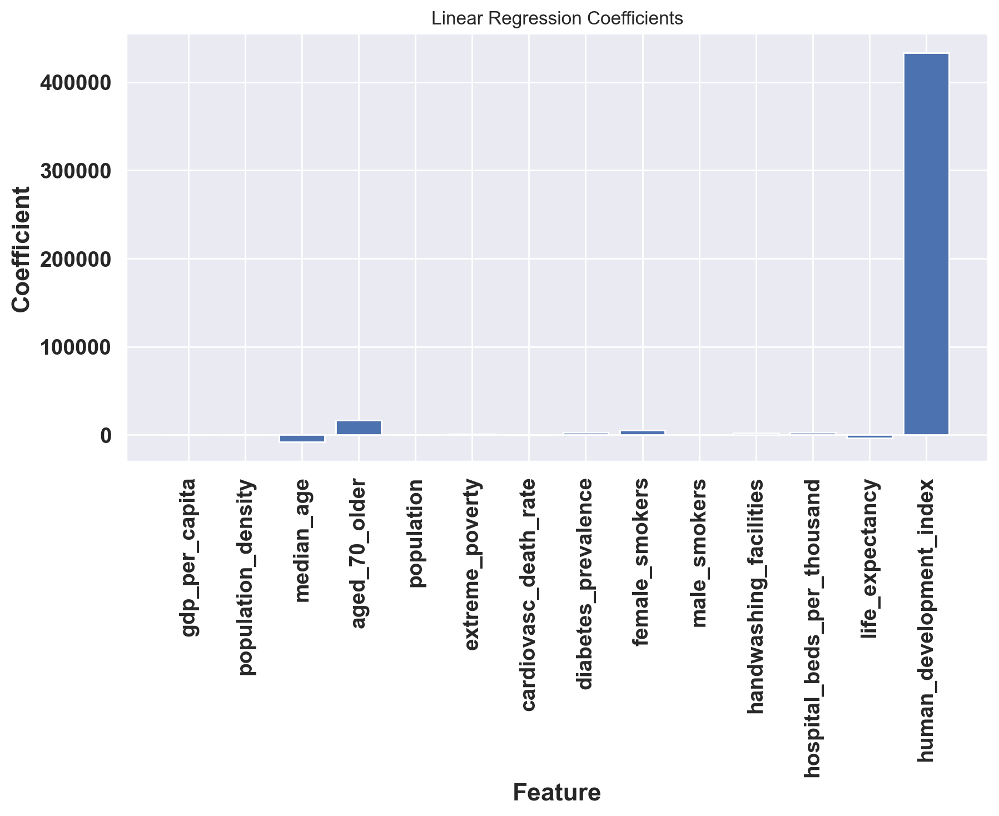

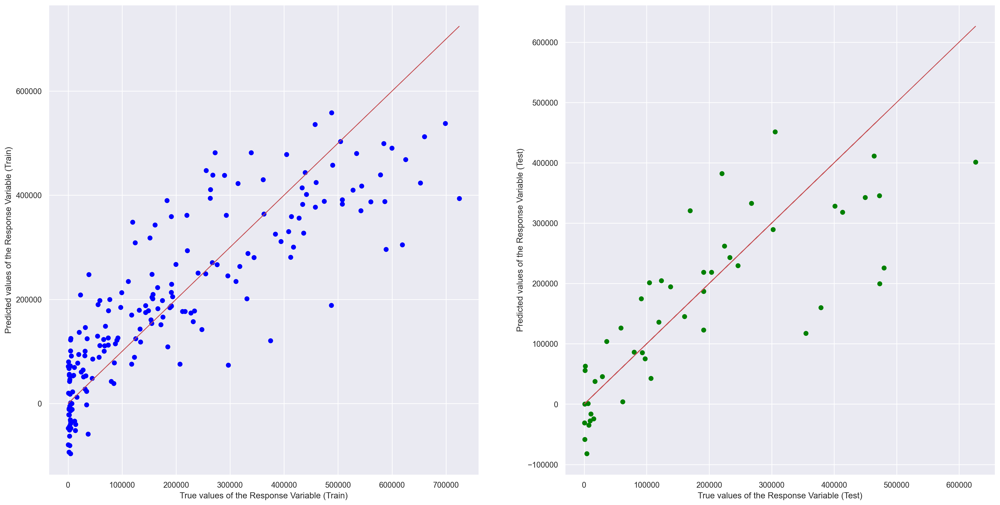

Explained Variance (R^2) on Train Set: 0.7272813653449196
Explained Variance (R^2) on Test Set: 0.6303368056248857


In [35]:
### Linear Regressor for Part1 (all )
LR_covid_df_part1 = MICE_sub_df.iloc[:,:-1]
LR_covid_df_part1.info()

# Extract the required variables from the dataset, and then perform Multi-Variate Regression
X = LR_covid_df_part1.drop(['total_cases_per_million'], axis=1)
y = LR_covid_df_part1['total_cases_per_million']


# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Train a linear regression model
reg = LinearRegression().fit(X_train, y_train)

# Make predictions on the test set
y_pred_train, y_pred_test = reg.predict(X_train), reg.predict(X_test)

# Calculate the mean squared error and r_2 on the test set
mse = mean_squared_error(y_test, y_pred_test)
print("Mean squared error:", mse)

r2  = r2_score(y_test, y_pred_test)
print("R squared error:", r2)

# Plot the coefficients of the features as a bar chart
plt.figure(figsize=(10,5))
plt.bar(X.columns, reg.coef_)
plt.xticks(rotation=90)
plt.ylabel('Coefficient')
plt.xlabel('Feature')
plt.title('Linear Regression Coefficients')

# for adjustments in fontsize, legend, rotation of xticks
plt.xticks(fontsize=14, fontweight='bold')
plt.yticks(fontsize=14, fontweight='bold')
plt.xlabel('Feature',fontsize=16, fontweight='bold')
plt.ylabel('Coefficient',fontsize=16, fontweight='bold')
plt.show()

# Plot the Predictions vs the True values
f, axes = plt.subplots(1, 2, figsize=(24, 12))
axes[0].scatter(y_train, y_pred_train, color = "blue")
axes[0].plot(y_train, y_train, 'r-', linewidth = 1)
axes[0].set_xlabel("True values of the Response Variable (Train)")
axes[0].set_ylabel("Predicted values of the Response Variable (Train)")

axes[1].scatter(y_test, y_pred_test, color = "green")
axes[1].plot(y_test, y_test, 'r-', linewidth = 1)
axes[1].set_xlabel("True values of the Response Variable (Test)")
axes[1].set_ylabel("Predicted values of the Response Variable (Test)")
plt.show()

# Print the R^2 score on the train set
print("Explained Variance (R^2) on Train Set:", reg.score(X_train, y_train))

# Print the R^2 score on the test set
print("Explained Variance (R^2) on Test Set:", reg.score(X_test, y_test))

<class 'pandas.core.frame.DataFrame'>
Int64Index: 260335 entries, 1 to 260335
Data columns (total 5 columns):
 #   Column                                      Non-Null Count   Dtype  
---  ------                                      --------------   -----  
 0   stringency_index                            260335 non-null  float64
 1   new_tests_smoothed_per_thousand             260335 non-null  float64
 2   new_people_vaccinated_smoothed_per_hundred  260335 non-null  float64
 3   new_cases_smoothed_per_million              260335 non-null  float64
 4   Lag_1                                       260335 non-null  float64
dtypes: float64(5)
memory usage: 11.9 MB
Train Mean Squared Error: 12182.279533156066
Validation/Test Mean Squared Error: 37138.33726793878
Train Mean Squared Error: 24637.21918566192
Validation/Test Mean Squared Error: 7397.327789757222


C:\Users\Admin\AppData\Local\Temp\ipykernel_9640\3859957686.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  LR_covid_df_part2['Lag_1'] = LR_covid_df_part2['new_cases_smoothed_per_million'].shift(1)


Train Mean Squared Error: 18883.471432242553
Validation/Test Mean Squared Error: 28930.48834649426
Train Mean Squared Error: 21394.579934611727
Validation/Test Mean Squared Error: 41958.95980509351
Train Mean Squared Error: 25499.345065734422
Validation/Test Mean Squared Error: 59783.823193766584


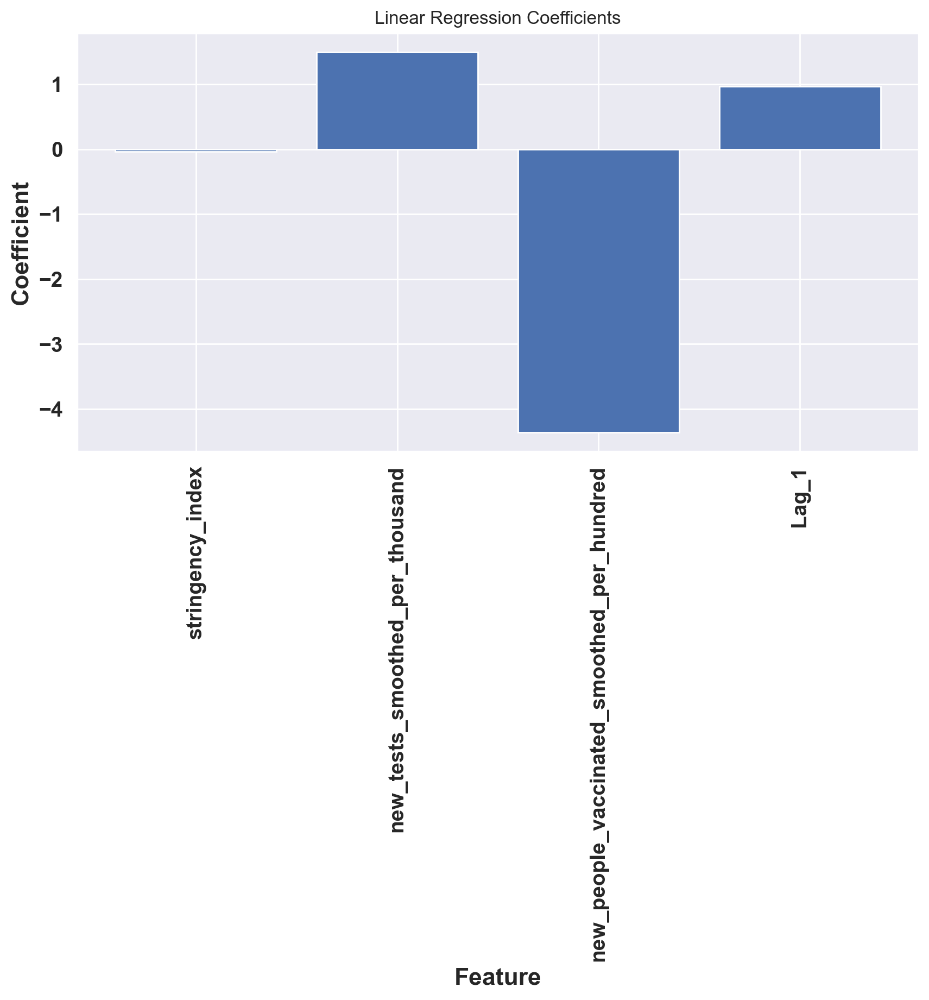

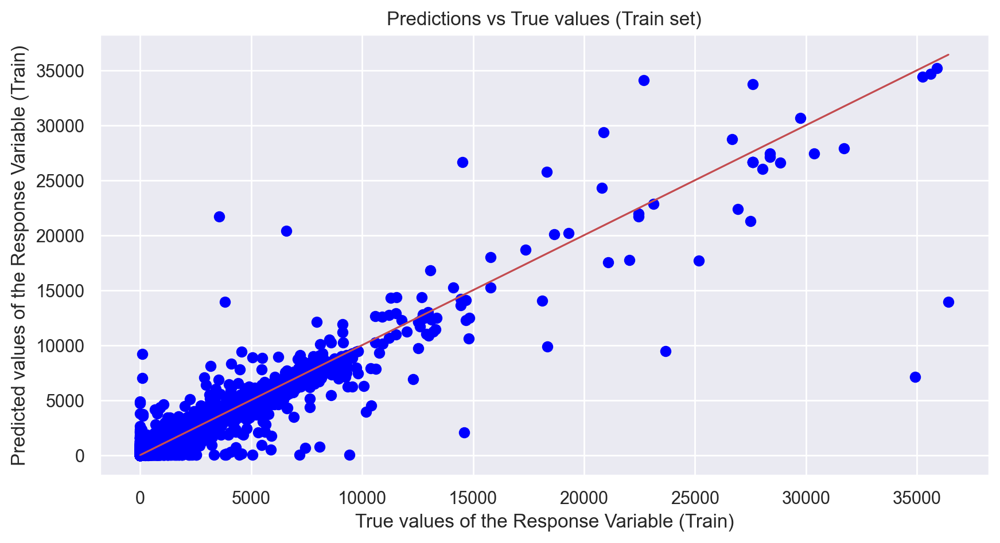

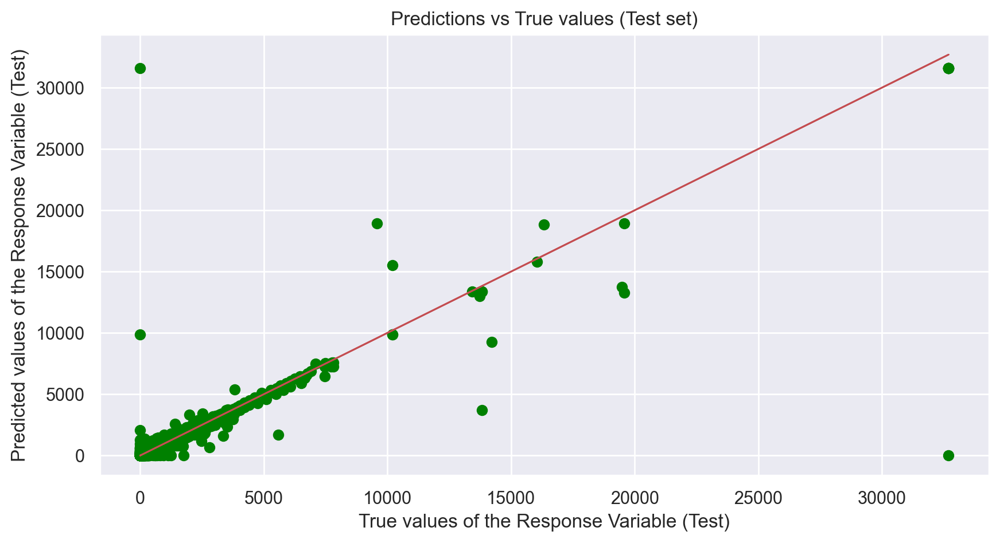

Explained Variance (R^2) on Train Set: 0.9396447843380696
Explained Variance (R^2) on Test Set: 0.8410387674434966


In [36]:
### Linear Regressor for Part 2
# Extract the required variables from the dataset, and then perform Multi-Variate Regression
LR_covid_df_part2 = covid_df_part2[progressColumns[3:6]+progressColumns[8:9]]       

#lag feature
LR_covid_df_part2['Lag_1'] = LR_covid_df_part2['new_cases_smoothed_per_million'].shift(1)

LR_covid_df_part2 = LR_covid_df_part2.dropna()
LR_covid_df_part2.info()

# Split the data into training and test sets using time series split
X = LR_covid_df_part2.drop(['new_cases_smoothed_per_million'], axis=1)
y = LR_covid_df_part2['new_cases_smoothed_per_million']
tscv = TimeSeriesSplit(n_splits=5)
train_loss, val_loss = [], [] # Initialize empty lists to store training and validation/test loss

# Create a Linear Regression object
linreg = LinearRegression()

for train_index, test_index in tscv.split(X):
    X_train, X_test = X.iloc[train_index], X.iloc[test_index]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]

    # Fit the Linear Regression model on the training data
    linreg.fit(X_train, y_train)

    # Predict the death values for the encoded test data using the Linear Regression model
    y_train_pred = linreg.predict(X_train)
    y_test_pred = linreg.predict(X_test)

    # Calculate the mean squared error for training and validation/test data
    train_mse = mean_squared_error(y_train, y_train_pred)
    val_mse = mean_squared_error(y_test, y_test_pred)
    train_loss.append(train_mse) # Append training loss to list
    val_loss.append(val_mse) # Append validation/test loss to list
    print("Train Mean Squared Error:", train_mse)
    print("Validation/Test Mean Squared Error:", val_mse)

# Plot the coefficients of the features as a bar chart
plt.figure(figsize=(10,5))
plt.bar(X.columns, linreg.coef_)
plt.xticks(rotation=90)
plt.ylabel('Coefficient')
plt.xlabel('Feature')
plt.title('Linear Regression Coefficients')

# for adjustments in fontsize, legend, rotation of xticks
plt.xticks(fontsize=14, fontweight='bold')
plt.yticks(fontsize=14, fontweight='bold')
plt.xlabel('Feature',fontsize=16, fontweight='bold')
plt.ylabel('Coefficient',fontsize=16, fontweight='bold')
plt.show()

# Plot the Predictions vs the True values
plt.figure(figsize=(10,5))
plt.scatter(y_train, y_train_pred, color = "blue")
plt.plot(y_train, y_train, 'r-', linewidth = 1)
plt.xlabel("True values of the Response Variable (Train)")
plt.ylabel("Predicted values of the Response Variable (Train)")
plt.title('Predictions vs True values (Train set)')

plt.figure(figsize=(10,5))
plt.scatter(y_test, y_test_pred, color = "green")
plt.plot(y_test, y_test, 'r-', linewidth = 1)
plt.xlabel("True values of the Response Variable (Test)")
plt.ylabel("Predicted values of the Response Variable (Test)")
plt.title('Predictions vs True values (Test set)')
plt.show()

# Print the R^2 score on the train set
print("Explained Variance (R^2) on Train Set:", linreg.score(X_train, y_train))

# Print the R^2 score on the test set
print("Explained Variance (R^2) on Test Set:", linreg.score(X_test, y_test))

Mean Squared Error: 6552978074.258291
R squared error: 0.7525332238302945


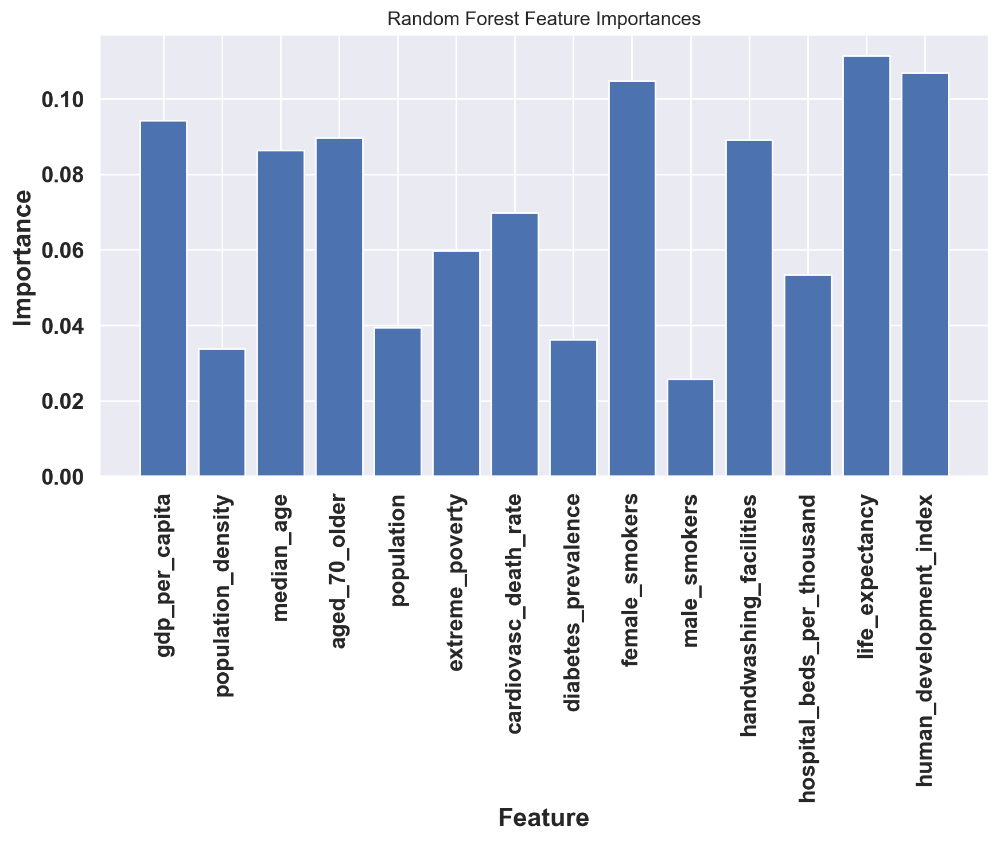

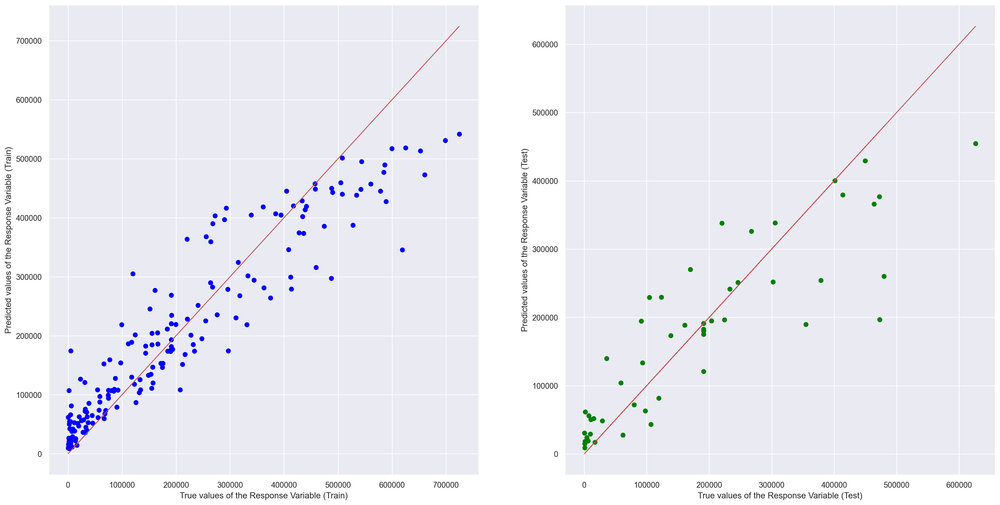

Explained Variance (R^2) on Train Set: 0.8737935769316875
Explained Variance (R^2) on Test Set: 0.7525332238302945


In [37]:
### Random Forest Model
# Load the data for new_cases, new_death, and new_tests, people_vaccinated
data =  MICE_sub_df.iloc[:,:-1]


# Split the data into training and test sets
X = data.drop(['total_cases_per_million'], axis=1)
y = data['total_cases_per_million']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)



# Create a random forest regressor
rf = RandomForestRegressor(n_estimators=100, max_depth=5, min_samples_split=2, min_samples_leaf=1, max_features= 1, random_state=42)

# Fit the random forest model
rf.fit(X_train, y_train)

# Predict the new cases values for the encoded test data
y_pred = rf.predict(X_test)

# Calculate the mean squared error
mse = mean_squared_error(y_test, y_pred)
print('Mean Squared Error:', mse)

r2  = r2_score(y_test, y_pred)
print("R squared error:", r2)

# Plot the feature importances as a bar chart
plt.figure(figsize=(10,5))
plt.bar(X.columns, rf.feature_importances_)
plt.xticks(rotation=90)
plt.ylabel('Importance')
plt.xlabel('Feature')
plt.title('Random Forest Feature Importances')

# Adjust the font size, label size, and rotation of xticks
plt.xticks(fontsize=14, fontweight='bold')
plt.yticks(fontsize=14, fontweight='bold')
plt.xlabel('Feature',fontsize=16, fontweight='bold')
plt.ylabel('Importance',fontsize=16, fontweight='bold')
plt.show()

# Plot the Predictions vs the True values
f, axes = plt.subplots(1, 2, figsize=(24, 12))
axes[0].scatter(y_train, rf.predict(X_train), color = "blue")
axes[0].plot(y_train, y_train, 'r-', linewidth = 1)
axes[0].set_xlabel("True values of the Response Variable (Train)")
axes[0].set_ylabel("Predicted values of the Response Variable (Train)")

axes[1].scatter(y_test, rf.predict(X_test), color = "green")
axes[1].plot(y_test, y_test, 'r-', linewidth = 1)
axes[1].set_xlabel("True values of the Response Variable (Test)")
axes[1].set_ylabel("Predicted values of the Response Variable (Test)")
plt.show()

# Print the R^2 score on the train set
print("Explained Variance (R^2) on Train Set:", rf.score(X_train, y_train))

# Print the R^2 score on the test set
print("Explained Variance (R^2) on Test Set:", rf.score(X_test, y_test))